# YoloV3 TF2 GPU Colab Notebook

##### 0.  Clone the YOLOv3 Repo

In [1]:
from IPython.display import clear_output
import os

if not os.path.isdir('yolov3-tf2'):
    !git clone https://github.com/zzh8829/yolov3-tf2

clear_output()

##### 1.  Download and Convert Pretrained Model

In [2]:
%cd yolov3-tf2/

if not os.path.isfile('data/yolov3.weights'):
    !wget https://pjreddie.com/media/files/yolov3.weights -O data/yolov3.weights
    !python convert.py

    clear_output()

%cd ../

/home/tham/Desktop/phd/yolov3-tf2
/home/tham/Desktop/phd


In [3]:
if not os.path.isfile('mobilenet_disaster.h5'):
    !wget https://github.com/yjwong1999/Representation-Similarity-Analysis/blob/main/mobilenet_disaster.zip?raw=true -O mobilenet_disaster.zip
    !unzip mobilenet_disaster.zip
    os.remove('mobilenet_disaster.zip')
    clear_output()

##### 2. Utilities Function

In [4]:
def YOLO_make_gradcam_heatmap(img_array, grad_cam):
    # Then, we compute the gradient of the objectness score
    # with respect to the activations of the targetted layers
    heatmaps = []
    for i in range(3):
        with tf.GradientTape() as tape:
            _, _, _, last_conv_layer_outputs, objs = grad_cam(img_array)
            last_conv_layer_output =last_conv_layer_outputs[i]
            objs = objs[i] # first dim is batch size, ignore it

        # This is the gradient of the output neuron (objectness scores)
        # with regard to the output feature map of the targetted layers
        grads = tape.gradient(objs, last_conv_layer_output)

        # This is a vector where each entry is the mean intensity of the gradient
        # over a specific feature map channel
        pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

        # We multiply each channel in the feature map array
        # by "how important this channel is" with regard to the objectness scores
        # then sum all the channels to obtain the heatmap "objectness" activation
        last_conv_layer_output = last_conv_layer_output[0]
        heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
        heatmap = tf.squeeze(heatmap)

        # For visualization purpose, we will also normalize the heatmap between 0 & 1
        heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)

        # append
        heatmaps.append(heatmap.numpy())

    return heatmaps

In [5]:
def Disaster_make_gradcam_heatmap(img_array, grad_model,  pred_index=None):
    # Then, we compute the gradient of the top predicted class for our input image
    # with respect to the activations of the last conv layer
    img_array = tf.keras.layers.experimental.preprocessing.Resizing(224, 224)(img_array)
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]

    # This is the gradient of the output neuron (top predicted or chosen)
    # with regard to the output feature map of the last conv layer
    grads = tape.gradient(class_channel, last_conv_layer_output)

    # This is a vector where each entry is the mean intensity of the gradient
    # over a specific feature map channel
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))

    # We multiply each channel in the feature map array
    # by "how important this channel is" with regard to the top predicted class
    # then sum all the channels to obtain the heatmap class activation
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)

    # For visualization purpose, we will also normalize the heatmap between 0 & 1
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

In [6]:
import matplotlib.cm as cm

def save_and_display_gradcam(img_array, heatmap, alpha=0.4):
    # convert img eager tensor to np array in range 0-255
    img = np.array(img_array[0])
    img = np.uint8(255 * img)

    # Rescale heatmap to a range 0-255
    heatmap = np.uint8(255 * heatmap)

    # Use jet colormap to colorize heatmap
    jet = cm.get_cmap("jet")

    # Use RGB values of the colormap
    jet_colors = jet(np.arange(256))[:, :3]
    jet_heatmap = jet_colors[heatmap]

    # Create an image with RGB colorized heatmap
    jet_heatmap = tf.keras.preprocessing.image.array_to_img(jet_heatmap)
    jet_heatmap = jet_heatmap.resize((img.shape[1], img.shape[0]))
    jet_heatmap = tf.keras.preprocessing.image.img_to_array(jet_heatmap)

    # Superimpose the heatmap on original image
    superimposed_img = jet_heatmap * alpha + img
    superimposed_img = tf.keras.preprocessing.image.array_to_img(superimposed_img)

    return superimposed_img

In [7]:
if 'count' not in globals():
    count = -1
count += 1

# plot the superimposed images
def plot_superimposed(superimposed_imgs, disaster_superimposed_img, headers):
    # set the font globally
    plt.rcParams["font.serif"] = ["Times New Roman"]
    fig = plt.figure(figsize= (19*2, 4.75*2))
    fig.tight_layout()
    fig.set_dpi(112)
    fig.subplots_adjust(top=0.75)
    fig.suptitle('Comparison of GradCAM on the Last Convolution Layers of the Given Layers', fontsize=28)
    axs = fig.subplots(1, 4)
    i = 0  

    axs[i].imshow(yolo_superimposed_imgs[0])
    axs[i].axis('off')
    axs[i].set_title(headers[i], fontsize=28)
    i += 1

    axs[i].imshow(yolo_superimposed_imgs[1])
    axs[i].axis('off')
    axs[i].set_title(headers[i], fontsize=28)
    i += 1

    axs[i].imshow(yolo_superimposed_imgs[2])
    axs[i].axis('off')
    axs[i].set_title(headers[i], fontsize=28)
    i += 1

    axs[i].imshow(disaster_superimposed_img)
    axs[i].axis('off')
    axs[i].set_title(headers[i], fontsize=28)
    i += 1

    fn = f'download_{count}.jpg'
    plt.savefig(fn, bbox_inches='tight')
    plt.show()

##### 3. Initialize Detector

In [8]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras import Model 
from tensorflow.keras.models import load_model
from tensorflow.keras.layers import (
    Add,
    Concatenate,
    Conv2D,
    DepthwiseConv2D,
    Input,
    Lambda,
    ReLU,
    LeakyReLU,
    UpSampling2D,
    ZeroPadding2D,
    BatchNormalization,
    GlobalAveragePooling2D,
    Dense,
    Dropout,
)
from tensorflow.keras.regularizers import l2
from tensorflow.keras.losses import (
    binary_crossentropy,
    sparse_categorical_crossentropy
)



from tensorflow.keras.layers import Activation, Reshape


from tensorflow.keras import backend as K


def _make_divisible(v, divisor, min_value=None):
    if min_value is None:
        min_value = divisor
    new_v = max(min_value, int(v + divisor / 2) // divisor * divisor)
    # Make sure that round down does not go down by more than 10%.
    if new_v < 0.9 * v:
        new_v += divisor
    return new_v



def _conv_block(inputs, filters, kernel, strides):
    """Convolution Block
    This function defines a 2D convolution operation with BN and relu6.
    # Arguments
        inputs: Tensor, input tensor of conv layer.
        filters: Integer, the dimensionality of the output space.
        kernel: An integer or tuple/list of 2 integers, specifying the
            width and height of the 2D convolution window.
        strides: An integer or tuple/list of 2 integers,
            specifying the strides of the convolution along the width and height.
            Can be a single integer to specify the same value for
            all spatial dimensions.
    # Returns
        Output tensor.
    """

    channel_axis = 1 if K.image_data_format() == 'channels_first' else -1

    x = Conv2D(filters, kernel, padding='same', strides=strides, kernel_regularizer=l2(0.0005))(inputs)
    x = BatchNormalization(axis=channel_axis)(x)
    return tf.keras.layers.ReLU(max_value=6.0, negative_slope=0.0, threshold=0.0)(x)


def _bottleneck(inputs, filters, kernel, t, alpha, s, r=False):
    """Bottleneck
    This function defines a basic bottleneck structure.
    # Arguments
        inputs: Tensor, input tensor of conv layer.
        filters: Integer, the dimensionality of the output space.
        kernel: An integer or tuple/list of 2 integers, specifying the
            width and height of the 2D convolution window.
        t: Integer, expansion factor.
            t is always applied to the input size.
        s: An integer or tuple/list of 2 integers,specifying the strides
            of the convolution along the width and height.Can be a single
            integer to specify the same value for all spatial dimensions.
        alpha: Integer, width multiplier.
        r: Boolean, Whether to use the residuals.
    # Returns
        Output tensor.
    """

    channel_axis = 1 if K.image_data_format() == 'channels_first' else -1
    # Depth
    tchannel = K.int_shape(inputs)[channel_axis] * t
    # Width
    cchannel = int(filters * alpha)

    x = _conv_block(inputs, tchannel, (1, 1), (1, 1))

    x = DepthwiseConv2D(kernel, strides=(s, s), depth_multiplier=1, padding='same', kernel_regularizer=l2(0.0005))(x)
    x = BatchNormalization(axis=channel_axis)(x)
    x = tf.keras.layers.ReLU(max_value=6.0, negative_slope=0.0, threshold=0.0)(x)

    x = Conv2D(cchannel, (1, 1), strides=(1, 1), padding='same', kernel_regularizer=l2(0.0005))(x)
    x = BatchNormalization(axis=channel_axis)(x)

    if r:
        x = Add()([x, inputs])

    return x


def _inverted_residual_block(inputs, filters, kernel, t, alpha, strides, n):
    """Inverted Residual Block
    This function defines a sequence of 1 or more identical layers.
    # Arguments
        inputs: Tensor, input tensor of conv layer.
        filters: Integer, the dimensionality of the output space.
        kernel: An integer or tuple/list of 2 integers, specifying the
            width and height of the 2D convolution window.
        t: Integer, expansion factor.
            t is always applied to the input size.
        alpha: Integer, width multiplier.
        s: An integer or tuple/list of 2 integers,specifying the strides
            of the convolution along the width and height.Can be a single
            integer to specify the same value for all spatial dimensions.
        n: Integer, layer repeat times.
    # Returns
        Output tensor.
    """

    x = _bottleneck(inputs, filters, kernel, t, alpha, strides)

    for i in range(1, n):
        x = _bottleneck(x, filters, kernel, t, alpha, 1, True)

    return x

In [9]:
%cd yolov3-tf2

import tensorflow as tf
import matplotlib.pyplot as plt
import sys
from absl import app, logging, flags
from absl.flags import FLAGS
import time
import cv2
import numpy as np
import tensorflow as tf
from yolov3_tf2.models import *
from yolov3_tf2.dataset import transform_images, load_tfrecord_dataset
from yolov3_tf2.utils import draw_outputs

flags.DEFINE_string('classes', './data/coco.names', 'path to classes file')
flags.DEFINE_string('weights', './checkpoints/yolov3.tf',
                    'path to weights file')
flags.DEFINE_boolean('tiny', False, 'yolov3 or yolov3-tiny')
flags.DEFINE_integer('size', 416, 'resize images to')
flags.DEFINE_string('image', './data/girl.png', 'path to input image')
flags.DEFINE_string('tfrecord', None, 'tfrecord instead of image')
flags.DEFINE_string('output', './output.jpg', 'path to output image')
flags.DEFINE_integer('num_classes', 80, 'number of classes in the model')

app._run_init(['yolov3'], app.parse_flags_with_usage)

physical_devices = tf.config.experimental.list_physical_devices('GPU')
if physical_devices:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

%cd ../

/home/tham/Desktop/phd/yolov3-tf2
/home/tham/Desktop/phd


2022-10-08 00:41:30.210226: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-08 00:41:30.219505: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-08 00:41:30.220008: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


In [10]:
def YOLOGradCAM(size=None, channels=3, last=True, anchors=yolo_anchors,
           masks=yolo_anchor_masks, classes=80):
    '''
    args:
    1) size: 
        the img resolution for the YOLOv3 (typically 416)
        just leave it as None for flexibility
    2) channels
        number of channels (typically 3, because RGB images)
    3) last 
        last layers before the output layer or not
        usually we plot the GradCAM visualization of the last layers before the output layer
        but you may plot other layer also (i.e., the 3 output of DarkNet-53)
    4) anchors
        yolo anchor boxes
    5) masks
        yolo anchor masks
    6) classes
        number of classes (MS-COCO is 80 classes)
    '''
    x = inputs = tf.keras.layers.Input([size, size, channels], name='input')

    x_36, x_61, x_91 = Darknet(name='yolo_darknet')(x) # the 3 outputs of DarkNet-53

    x_0 = YoloConv(512, name='yolo_conv_0')(x_91)
    output_0 = YoloOutput(512, len(masks[0]), classes, name='yolo_output_0')(x_0)

    x_1 = YoloConv(256, name='yolo_conv_1')((x_0, x_61))
    output_1 = YoloOutput(256, len(masks[1]), classes, name='yolo_output_1')(x_1)

    x_2 = YoloConv(128, name='yolo_conv_2')((x_1, x_36))
    output_2 = YoloOutput(128, len(masks[2]), classes, name='yolo_output_2')(x_2)

    outputs = [output_0, output_1, output_2] # output of the 3 head models of YOLOv3

    # take note!
    # each output is (BS, N, N, Anc, Preds), where
    #   BS is batch size
    #   N is the size of outputs (13, 26, or 52)
    #   Anc is the number of anchors per output (3)
    #   Preds is (x, y, w, h, obj, ...cls)), dimension is 5 + number of class
    # a typical output is (1, 13, 13, 3, 85), (1, 26, 26, 3, 85), (1, 52, 52, 3, 85)
    
    # get objectnes_scores
    objectnes_scores = []
    # loop output for each head model
    for out_idx in range(3):
        # get (BS, N, N, Anc, obj only)
        obj_0 = outputs[out_idx][:,:,:,0,4] # get (1, N, N, Anc=0, obj only)
        obj_1 = outputs[out_idx][:,:,:,1,4] # get (1, N, N, Anc=1, obj only)
        obj_2 = outputs[out_idx][:,:,:,2,4] # get (1, N, N, Anc=2, obj only)

        # each grid (N, N) in obj_0 to obj_2 are prediction on the same thing
        # just with diff anchor aspect ratio
        # we will get the max predictions among all (collapse prediction of each anchor into one)
        obj_0 = tf.expand_dims(obj_0, axis=1)
        obj_1 = tf.expand_dims(obj_1, axis=1)
        obj_2 = tf.expand_dims(obj_2, axis=1)
        obj = tf.concat((obj_0, obj_1, obj_2), axis=1)
        obj = tf.reduce_max(obj, axis=1)
        
        # apply sigmoid, because the objectness score here will be sigmoid-ed by the decoder + NMS layers
        obj = tf.sigmoid(obj)

        objectnes_scores.append(obj)

    # if plot GradCAM for last layers
    if last:
        fmaps = [x_2, x_1, x_0]
        objectnes_scores.reverse()
    # if plot GradCAM for DarkNet-53 outputs
    else:
        fmaps = [x_36, x_61, x_91]

    # fmaps is the layers we want to backprop the gradients to
    # objectness_score is the prediction on the objectness of each grid of each output
    return tf.keras.models.Model(inputs, (output_0, output_1, output_2, fmaps, objectnes_scores), name='grad_cam')

In [11]:
tf.keras.backend.clear_session()

##############################################################################
# MODEL
##############################################################################
def MobileNetBackbone(target_layer_name='block_12_add'):
    # pretrained model
    base_model = tf.keras.applications.MobileNetV2(input_shape=(224, 224, 3),
                                                   include_top=False,
                                                   weights='imagenet')
    fmap_0 = base_model.get_layer(target_layer_name).output
    fmap_1 = base_model.output
    
    return tf.keras.Model(inputs=base_model.input, outputs=[fmap_0, fmap_1], name='mobilenet')

def DisasterGradCam(last=False, target_layer_name='block_12_add'):
    '''
    args:
    1) last
        is it the last layers before the output layer that you want to visualize
    2) target_layer_name
        the name of the layer you wan to visualize
        IGNORED IF last = True
    '''
    base_model = MobileNetBackbone(target_layer_name=target_layer_name)
    preprocess_input = tf.keras.applications.mobilenet_v2.preprocess_input
    base_model.trainable=True
    
    # create the global model
    inputs = tf.keras.Input(shape=(224, 224, 3))
    x = preprocess_input(inputs)
    x1, x2 = base_model(x)
    if last:
        fmap = x2
    else:
        fmap = x1
    
    x = tf.keras.layers.GlobalAveragePooling2D()(x2)
    x = tf.keras.layers.Reshape((1, 1, 1280))(x)
    x = tf.keras.layers.Dropout(0.3, name='Dropout')(x)
    x = tf.keras.layers.Conv2D(7, (1, 1), padding='same')(x)
    x = tf.keras.layers.Activation('softmax', name='softmax')(x)
    outputs = tf.keras.layers.Reshape((7,))(x)
    
    model = tf.keras.Model(inputs, [fmap, outputs])
    
    return model

##### 4. Get Some Sample Images

For this tutorial, I use CrisisIBD dataset (which is used in my research projects)

In [12]:
import os
import timeit
import shutil
from IPython.display import clear_output

# Remove the sample data to free up some spaces 
if os.path.isdir('sample_data'):
    shutil.rmtree('sample_data')

if not os.path.isdir('crisis_vision_benchmarks'):
    # get the tar gz file
    # https://www.youtube.com/watch?v=U-nsgM9XWtU&list=PLpoCVQU4m6j_jNSbNFBeyT-tchsbc3CLV&index=3
    t1 = timeit.default_timer()
    !wget --tries=30 https://crisisnlp.qcri.org/data/crisis_image_datasets_benchmarks/crisis_vision_benchmarks.tar.gz
    #!wget --continue --progress=dot:mega --tries=0 https://crisisnlp.qcri.org/data/crisis_image_datasets_benchmarks/crisis_vision_benchmarks.tar.gz
    t2 = timeit.default_timer()

    clear_output()
    print('Total time to download the dataset: {:.2f} min'.format((t2-t1) / 60))

In [13]:
if not os.path.isdir('crisis_vision_benchmarks'):
    # extract the tar gz file using previous tutorial
    t1 = timeit.default_timer()
    !tar --gunzip --extract --verbose --file=crisis_vision_benchmarks.tar.gz
    t2 = timeit.default_timer()

    clear_output()
    print('Total time to extract the dataset: {:.2f} min'.format((t2-t1) / 60))

    # remove the tar gz file to save space
    os.remove('crisis_vision_benchmarks.tar.gz')
    
    # remove additional dataset
    shutil.rmtree('crisis_vision_benchmarks/data/ASONAM17_Damage_Image_Dataset')
    shutil.rmtree('crisis_vision_benchmarks/data/aidr_info')

##### 5.  Create tf.Dataset

In [14]:
# %cd ../

import pandas as pd
import numpy as np

data_root = 'crisis_vision_benchmarks/'

annot_train_path = 'crisis_vision_benchmarks/tasks/disaster_types/consolidated/consolidated_disaster_types_train_final.tsv'
annot_dev_path = 'crisis_vision_benchmarks/tasks/disaster_types/consolidated/consolidated_disaster_types_dev_final.tsv'
annot_test_path = 'crisis_vision_benchmarks/tasks/disaster_types/consolidated/consolidated_disaster_types_test_final.tsv'
    
# training data
print('TRAINING')
df = pd.read_csv(annot_train_path, sep='\t')
new_df = df.loc[(df['class_label']=='earthquake') 
                | (df['class_label']=='fire') 
                | (df['class_label']=='flood') 
                | (df['class_label']=='hurricane') 
                | (df['class_label']=='not_disaster') 
                | (df['class_label']=='other_disaster') 
                | (df['class_label']=='landslide') 
                ]

new_df = new_df.reset_index(drop=True)
print(f'Filtered out {new_df.shape[0]} / {df.shape[0]} images')
train_img_paths = new_df['image_path'].tolist()
train_labels = new_df['class_label'].tolist()

# dev data
print('\nVALIDATION')
df = pd.read_csv(annot_dev_path, sep='\t')
new_df = df.loc[(df['class_label']=='earthquake') 
                | (df['class_label']=='fire') 
                | (df['class_label']=='flood') 
                | (df['class_label']=='hurricane') 
                | (df['class_label']=='not_disaster') 
                | (df['class_label']=='other_disaster') 
                | (df['class_label']=='landslide') 
                ]
new_df = new_df.reset_index(drop=True)
print(f'Filtered out {new_df.shape[0]} / {df.shape[0]} images')
dev_img_paths = new_df['image_path'].tolist()
dev_labels = new_df['class_label'].tolist()

# test data
print('\nTEST')
df = pd.read_csv(annot_test_path, sep='\t')
new_df = df.loc[(df['class_label']=='earthquake') 
                | (df['class_label']=='fire') 
                | (df['class_label']=='flood') 
                | (df['class_label']=='hurricane') 
                | (df['class_label']=='not_disaster') 
                | (df['class_label']=='other_disaster') 
                | (df['class_label']=='landslide') 
                ]
new_df = new_df.reset_index(drop=True)
print(f'Filtered out {new_df.shape[0]} / {df.shape[0]} images')
test_img_paths = new_df['image_path'].tolist()
test_labels = new_df['class_label'].tolist()

# example
new_df.head()

TRAINING
Filtered out 12846 / 12846 images

VALIDATION
Filtered out 1470 / 1470 images

TEST
Filtered out 3195 / 3195 images


,event_name,image_id,image_path,class_label
0,AIDR,1051850186446831618_0,data/aidr_disaster_types/hurricane_michael_201...,hurricane
1,AIDR,961262549005230080_2,data/aidr_disaster_types/natural_disaster/7_2_...,earthquake
2,AIDR,1037983665995706368_0,data/aidr_disaster_types/kerala_flood_2018/7_9...,flood
3,AIDR,597324321418149888_0,data/aidr_disaster_types/nepal_earthquake/10_5...,earthquake
4,AIDR,673228466414686208_0,data/aidr_disaster_types/chennai_flood/5_12_20...,not_disaster


In [15]:
# # we use 400 images from validataion dataset for RSA
# dev_img_paths= dev_img_paths[:500]
# dev_labels = dev_labels[:500]

In [16]:
import numpy as np

np.random.seed(520)
np.random.shuffle(train_img_paths)
np.random.seed(520)
np.random.shuffle(train_labels)

np.random.seed(520)
np.random.shuffle(dev_img_paths)
np.random.seed(520)
np.random.shuffle(dev_labels)

np.random.seed(520)
np.random.shuffle(test_img_paths)
np.random.seed(520)
np.random.shuffle(test_labels)

In [17]:
import tensorflow as tf

data_root = tf.convert_to_tensor(data_root, tf.string)

def load_data(image_path):
    # read the image from disk, decode it, resize it, and scale the
    # pixels intensities to the range [0, 1]
    image_path = tf.strings.join([data_root, image_path])
    image = tf.io.read_file(image_path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, (FLAGS.size, FLAGS.size)) / 255.0
    # return the image and the integer encoded label
    return image

train_data = tf.data.Dataset.from_tensor_slices(train_img_paths)
val_data = tf.data.Dataset.from_tensor_slices(dev_img_paths)
test_data = tf.data.Dataset.from_tensor_slices(test_img_paths)

2022-10-08 00:41:44.618445: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-10-08 00:41:44.620947: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-08 00:41:44.622425: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-10-08 00:41:44.623655: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:975] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zer

In [18]:
trainDS = (train_data
	.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
	.batch(1)
	.prefetch(tf.data.AUTOTUNE)
)

valDS = (val_data
	.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
	.batch(1)
	.prefetch(tf.data.AUTOTUNE)
)

testDS = (test_data
	.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
	.batch(1)
	.prefetch(tf.data.AUTOTUNE)
)

In [19]:
# check specification of the element of this dataset
print('Specification of element in this dataset')
print(trainDS.element_spec)

# get a BATCH of dataset for inspection
for element in testDS.as_numpy_iterator():
    break

print('\nExtract a BATCH from the dataset')
print(element.shape)

Specification of element in this dataset
TensorSpec(shape=(None, 416, 416, 3), dtype=tf.float32, name=None)

Extract a BATCH from the dataset
(1, 416, 416, 3)


##### 6. GradCAM

In [20]:
# load the pretrained model
%cd yolov3-tf2

yolo = YoloV3(classes=FLAGS.num_classes, training=True)
yolo.load_weights(FLAGS.weights).expect_partial()
logging.info('weights loaded')

%cd ../

/home/tham/Desktop/phd/yolov3-tf2


I1008 00:41:52.028483 139793961649984 1033493293.py:6] weights loaded


/home/tham/Desktop/phd


In [21]:
# initialize the GradCAM for YOLOv3
LAST = True
tf.keras.backend.clear_session()
yolo_grad_cam = YOLOGradCAM(classes=FLAGS.num_classes, last=LAST)

# transfer learning
layer_names = []
for layer in yolo.layers:
    layer_names.append(layer.name)

for layer_name in layer_names:
    if 'boxes' in layer_name or 'nms' in layer_name:
        continue
    yolo_grad_cam.get_layer(layer_name).set_weights(
        yolo.get_layer(layer_name).get_weights()
    )

In [22]:
pretrained_disaster_model = tf.keras.models.load_model('mobilenet_disaster.h5')
pretrained_disaster_model.get_layer('mobilenetv2_1.00_224').save('mobilenet.h5')

W1008 00:41:55.447812 139793961649984 saving_utils.py:328] Compiled the loaded model, but the compiled metrics have yet to be built. `model.compile_metrics` will be empty until you train or evaluate the model.


In [23]:
# initialize GradCAM for MobileNetv2
%cd yolov3-tf2

tf.keras.backend.clear_session()
disaster_gradcam = DisasterGradCam(last=LAST)

%cd ../

# load the pretrained MobileNetv2 on CrisisIBD dataset
disaster_gradcam.get_layer('mobilenet').load_weights('mobilenet.h5')

/home/tham/Desktop/phd/yolov3-tf2
/home/tham/Desktop/phd


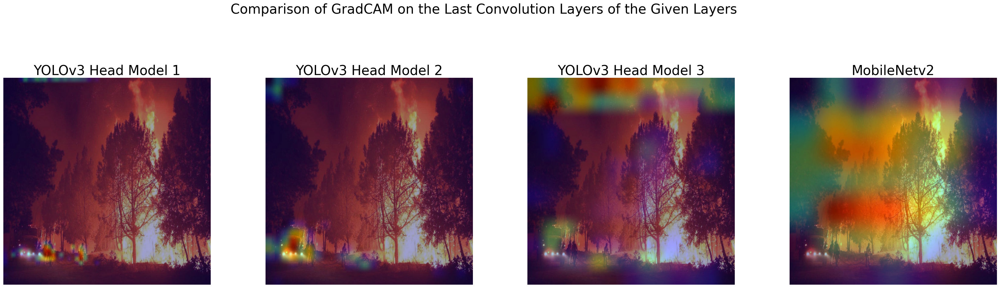

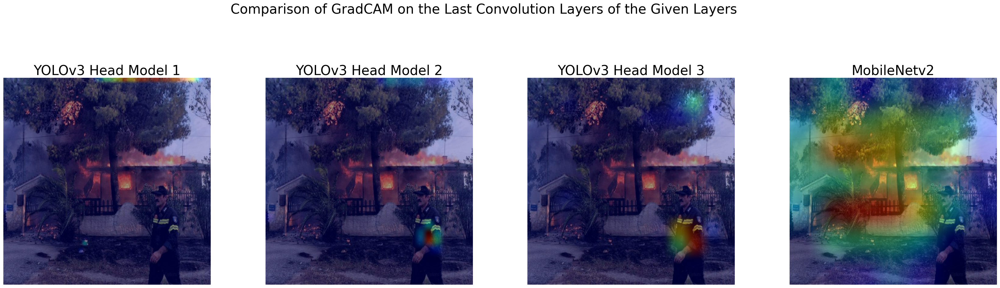

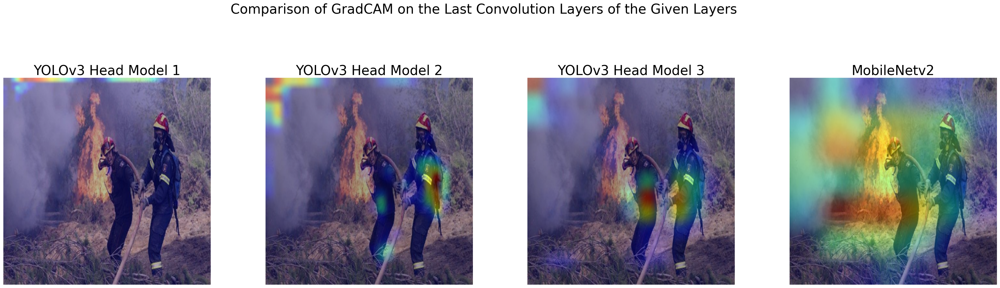

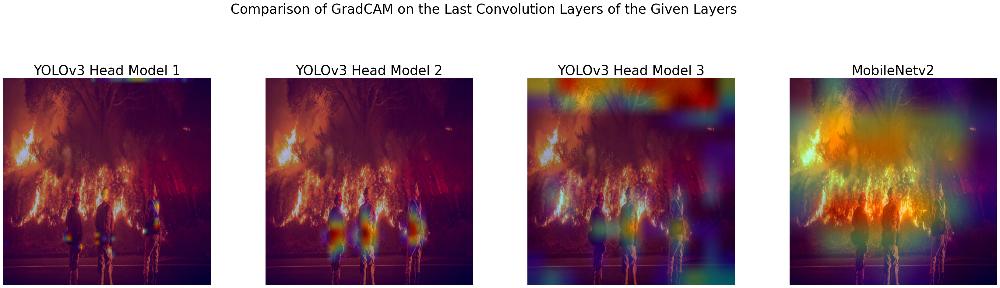

In [25]:
image_list = ['crisis_vision_benchmarks/data/crisismmd/data_image/california_wildfires/10_10_2017/917792147700465664_0.jpg',
              'crisis_vision_benchmarks/data/aidr_disaster_types/greece_wildfire_2018/24_7_2018/1021704660455972864_0.jpg',
              'crisis_vision_benchmarks/data/aidr_disaster_types/greece_wildfire_2018/24_7_2018/1021855035834036225_0.jpg',
              'crisis_vision_benchmarks/data/crisismmd/data_image/california_wildfires/22_10_2017/922015358227185664_0.jpg'
              ]

# load the image
resize = tf.keras.layers.experimental.preprocessing.Resizing(224, 224)
for img_path in image_list:
    FLAGS.image = img_path

    img_raw = tf.image.decode_image(
        open(FLAGS.image, 'rb').read(), channels=3)

    img = tf.expand_dims(img_raw, 0)
    img = transform_images(img, FLAGS.size)

    # use the GradCAM-YOLO to create the heatmap for the three output
    heatmaps = YOLO_make_gradcam_heatmap(img, yolo_grad_cam)

    # superimpose each heatmap onto the original input image
    yolo_superimposed_imgs = []
    for i in range(3):
        yolo_superimposed_img = save_and_display_gradcam(img, heatmaps[i], alpha=0.6)
        yolo_superimposed_imgs.append(yolo_superimposed_img)

    int_img = tf.cast(resize(img) * 255, dtype=tf.int32)
    disaster_heatmap = Disaster_make_gradcam_heatmap(img, disaster_gradcam)
    disaster_superimposed_img = save_and_display_gradcam(img, disaster_heatmap, alpha=0.6)

    # plot the superimposed images
    headers = ['YOLOv3 Head Model 1', 'YOLOv3 Head Model 2', 'YOLOv3 Head Model 3', 'MobileNetv2']
    plot_superimposed(yolo_superimposed_imgs, disaster_superimposed_img, headers=headers)

As we can observer from the plots, the **GradCAM visualization** on the **last output layers of MobileNetV2** and all **YOLOv3 Head Models** are not similar. 

**YOLOv3 Head Models** are highly specialized for **object detection**, while **MobileNetV2** (trained for disaster classification) are specialized in extracting the **background information**.

This means that they do not share similar feature maps.

##### 7. RSA

We can use **Representation Similarity Analysis (RSA)** to find the branching out location of YOLOv3 models, to add on a MobileNetV2-like head model for disaster classification.

In [26]:
# for layer extraction (to find the layer layers corresponding to N_B)
# tf.keras.utils.plot_model(disaster_gradcam.get_layer('mobilenet'), show_shapes=True)

In [27]:
tf.keras.backend.clear_session()
yolo_grad_cam = YOLOGradCAM(classes=FLAGS.num_classes, last=False)

tf.keras.backend.clear_session()
# 'block_15_add'    -> Base Model N_B = 6, Head Model N_B = 1
# 'block_12_add'    -> Base Model N_B = 5, Head Model N_B = 2
# 'block_9_add'     -> Base Model N_B = 4, Head Model N_B = 3
disaster_gradcam = DisasterGradCam(last=False, target_layer_name='block_12_add')

In [28]:
# transfer learning for DarkNet RSA
layer_names = []
for layer in yolo.layers:
    layer_names.append(layer.name)
    
for layer_name in layer_names:
    if 'boxes' in layer_name or 'nms' in layer_name:
        continue
    yolo_grad_cam.get_layer(layer_name).set_weights(
        yolo.get_layer(layer_name).get_weights()
    )

# extract model
darknet = yolo_grad_cam.get_layer('yolo_darknet')
outputs = [darknet.get_layer('add_10').output, darknet.get_layer('add_18').output, darknet.get_layer('add_22').output]
darknet_rsa = tf.keras.models.Model(darknet.input, outputs)
darknet_rsa.output

[<KerasTensor: shape=(None, None, None, 256) dtype=float32 (created by layer 'add_10')>,
 <KerasTensor: shape=(None, None, None, 512) dtype=float32 (created by layer 'add_18')>,
 <KerasTensor: shape=(None, None, None, 1024) dtype=float32 (created by layer 'add_22')>]

In [29]:
# transfer learning for MobileNet RSA
disaster_gradcam.get_layer('mobilenet').load_weights('mobilenet.h5')

# extract model
mobilenet = disaster_gradcam.get_layer('mobilenet')
mobilenet_rsa = tf.keras.models.Model(disaster_gradcam.input, disaster_gradcam.outputs[0])
mobilenet_rsa.output

<KerasTensor: shape=(None, 14, 14, 96) dtype=float32 (created by layer 'mobilenet')>

In [30]:
# pearson dissimilarity (1 - pearson correlation)
flatten = tf.keras.layers.Flatten()
resize = tf.keras.layers.experimental.preprocessing.Resizing(224, 224)

def pearson_dissim(x, y):
    """
    args 
        x, y: the input features
    return
        d: [0, 1] which means [very similar, very not similar]
    """
    # flatten
    x_ = flatten(x)
    y_ = flatten(y)
    # get mean
    x_mean = tf.reduce_mean(x_, axis=1)
    y_mean = tf.reduce_mean(y_, axis=1)
    # get element - mean
    x_mean = tf.expand_dims(x_mean, axis=-1)
    y_mean = tf.expand_dims(y_mean, axis=-1)
    x_ = x_ - x_mean
    y_ = y_ - y_mean 
    # get pearson correlation (r)
    numerator = tf.reduce_sum(x_ * y_, axis=-1)
    _ = tf.reduce_sum((x_ * x_), axis=-1) * tf.reduce_sum((y_ * y_), axis=-1)
    denominator = tf.math.sqrt(_)
    r = numerator / denominator
    # return pearson dissimilarity (1-r)
    d = 1 - r
    # d = tf.math.minimum(d, [1.0])
    # d = tf.math.maximum(d, [0.0])
    return d

# tensorflow dataset
rsa_DS = (test_data
	.map(load_data, num_parallel_calls=tf.data.AUTOTUNE)
	.batch(16) #1470
	.prefetch(tf.data.AUTOTUNE)
)

In [32]:
from scipy.stats import spearmanr
def get_spearman_rankcor(y_true, y_pred):
     return ( tf.py_function(spearmanr, [tf.cast(y_pred, tf.float32), 
                       tf.cast(y_true, tf.float32)], Tout = tf.float32) )

In [33]:
all_rdms = [None] * 4
# count = 0
for imgs in rsa_DS:
    # get the feature maps
    fmap_0 = mobilenet_rsa(tf.cast(resize(imgs) * 255, dtype=tf.int32))
    fmap_1, fmap_2, fmap_3 = darknet_rsa(imgs)
    # generate representation dissimilarity matrics (RDM)
    all_fmaps = [fmap_0, fmap_1, fmap_2, fmap_3]
    for idx, fmaps in enumerate(all_fmaps):
        pairings = None
        # generate all posible pairing for each feature maps
        for i in range(fmaps.shape[0]):
            for j in range(i + 1, fmaps.shape[0]):
                x1 = tf.expand_dims(fmaps[i], axis=0)
                x2 = tf.expand_dims(fmaps[j], axis=0)
                if pairings is None:
                    pairings = [x1, x2]
                else:
                    pairings[0] = tf.concat((pairings[0], x1), axis = 0)
                    pairings[1] = tf.concat((pairings[1], x2), axis = 0)
        # get rdm
        rdms = pearson_dissim(pairings[0], pairings[1])
        if all_rdms[idx] is None:
            all_rdms[idx] = rdms
        else:
            all_rdms[idx] = tf.concat((all_rdms[idx], rdms), axis=0)

    # count += 1
    # if count > 10:
    #     break

rdm_1 = all_rdms[0]
for i in range(1, len(all_rdms)):
    rdm_2 = all_rdms[i]
    r_s = get_spearman_rankcor(rdm_1, rdm_2)
    print(r_s)

tf.Tensor(0.3664451, shape=(), dtype=float32)
tf.Tensor(0.49017474, shape=(), dtype=float32)
tf.Tensor(0.48727494, shape=(), dtype=float32)


In [34]:
# all_fmaps = [None] * 4
# for imgs in rsa_DS:
#     # get the feature maps
#     fmap_0 = mobilenet_rsa(tf.cast(resize(imgs) * 255, dtype=tf.int32)) # mobilenet expects int type [0, 255] image
#     fmap_1, fmap_2, fmap_3 = darknet_rsa(imgs)
#     if all_fmaps[0] is None:
#         all_fmaps[0] = fmap_0.numpy()
#         all_fmaps[1] = fmap_1.numpy()
#         all_fmaps[2] = fmap_2.numpy()
#         all_fmaps[3] = fmap_3.numpy()
#     else:
#         all_fmaps[0] = tf.concat((all_fmaps[0], fmap_0.numpy()), axis = 0)
#         all_fmaps[1] = tf.concat((all_fmaps[1], fmap_1.numpy()), axis = 0)
#         all_fmaps[2] = tf.concat((all_fmaps[2], fmap_2.numpy()), axis = 0)
#         all_fmaps[3] = tf.concat((all_fmaps[3], fmap_3.numpy()), axis = 0)

# # generate representation dissimilarity matrics (RDM)
# all_rdms = []
# N = len(all_fmaps[0])
# for idx, fmaps in enumerate(all_fmaps):
#     # generate all posible pairing for each feature maps
#     rdms = []
#     for i in range(N):
#         for j in range(i + 1, N):
#             x1 = tf.expand_dims(fmaps[i], axis=0)
#             x2 = tf.expand_dims(fmaps[j], axis=0)
#             # get p_d for rdm
#             p_d = pearson_dissim(x1, x2)
#             rdms.append(p_d)
#     all_rdms.append(rdms)


# rdm_1 = np.array(all_rdms[0])
# for i in range(1, len(all_rdms)):
#     rdm_2 = np.array(all_rdms[i])
#     r_s = get_spearman_rankcor(rdm_1, rdm_2)
#     print(r_s)

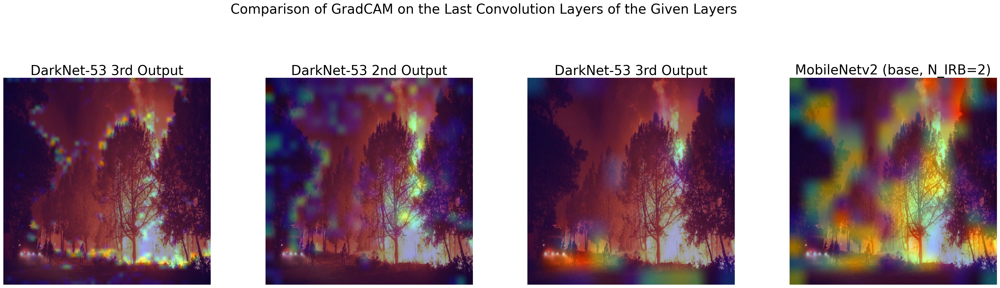

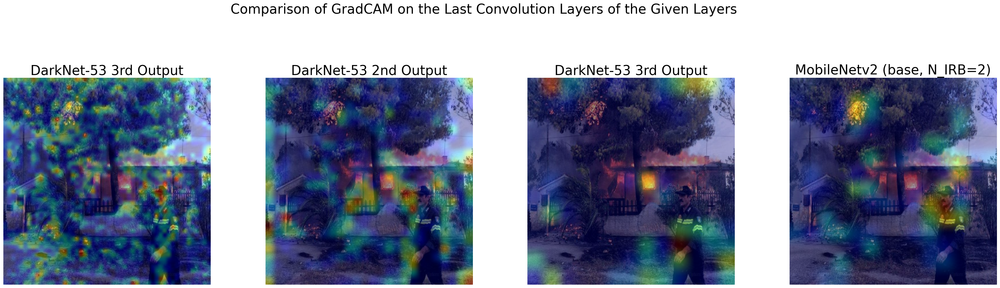

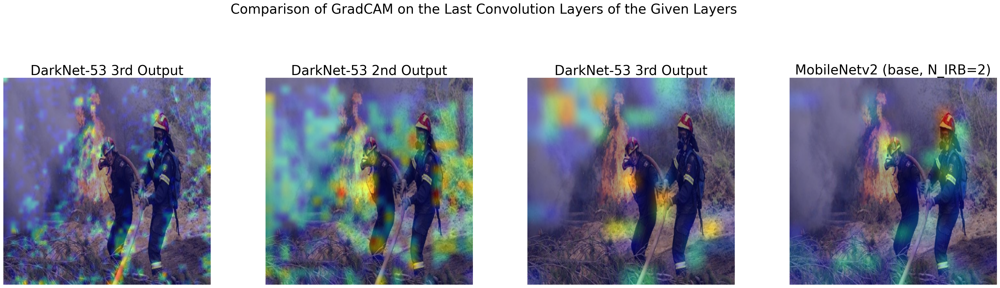

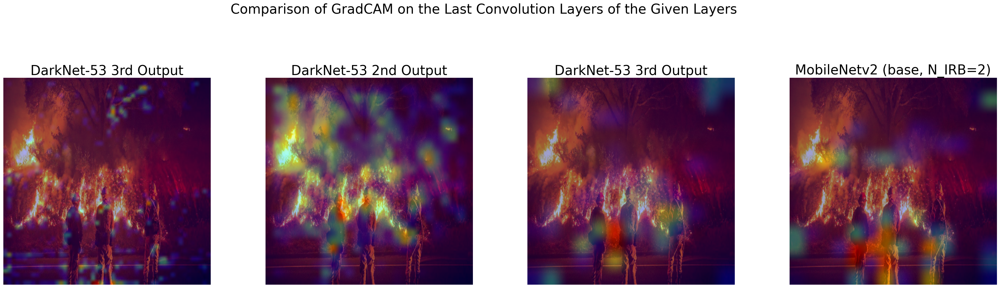

In [36]:
image_list = ['crisis_vision_benchmarks/data/crisismmd/data_image/california_wildfires/10_10_2017/917792147700465664_0.jpg',
              'crisis_vision_benchmarks/data/aidr_disaster_types/greece_wildfire_2018/24_7_2018/1021704660455972864_0.jpg',
              'crisis_vision_benchmarks/data/aidr_disaster_types/greece_wildfire_2018/24_7_2018/1021855035834036225_0.jpg',
              'crisis_vision_benchmarks/data/crisismmd/data_image/california_wildfires/22_10_2017/922015358227185664_0.jpg'
              ]

# image_list = ['crisis_vision_benchmarks/'+train_img_paths[29],
#               'crisis_vision_benchmarks/'+train_img_paths[30],
#               'crisis_vision_benchmarks/'+train_img_paths[31],
#               'crisis_vision_benchmarks/'+train_img_paths[13],
#               ]

# load the image
for img_path in image_list:
    FLAGS.image = img_path

    img_raw = tf.image.decode_image(
        open(FLAGS.image, 'rb').read(), channels=3)

    img = tf.expand_dims(img_raw, 0)
    img = transform_images(img, FLAGS.size)

    # use the GradCAM-YOLO to create the heatmap for the three output
    heatmaps = YOLO_make_gradcam_heatmap(img, yolo_grad_cam)

    # superimpose each heatmap onto the original input image
    yolo_superimposed_imgs = []
    for i in range(3):
        yolo_superimposed_img = save_and_display_gradcam(img, heatmaps[i], alpha=0.6)
        yolo_superimposed_imgs.append(yolo_superimposed_img)

    int_img = tf.cast(resize(img) * 255, dtype=tf.int32)
    disaster_heatmap = Disaster_make_gradcam_heatmap(int_img, disaster_gradcam)
    disaster_superimposed_img = save_and_display_gradcam(img, disaster_heatmap, alpha=0.6)

    # plot the superimposed images
    headers = ['DarkNet-53 3rd Output', 'DarkNet-53 2nd Output', 'DarkNet-53 3rd Output', 'MobileNetv2 (base, N_IRB=2)']
    plot_superimposed(yolo_superimposed_imgs, disaster_superimposed_img, headers=headers)

As we can observe here, the **2nd Output of DarkNet-53** has a more similar heatmap compared to **MobileNetV2 (base, N_IRB=2)**

**From Left to Right:** </br>
Left   : More Low Level Features </br>
Mid    : Semantic features + Objectness features </br>
High   : Mostly objectness features (not-refined yet) </br>

Thus, our GradCAM Heatmap Visualization aligns with our RSA analysis. </br>
Our RSA analysis shows that the two layers that have the highest similarity score is **DarkNet-53 2nd Output** and **MobileNetV2's N_IRB=2**

Since MobileNetV2 (N_IRB=2) and DarkNet-53 2nd Output produces correlated feature maps, we can:
- utilize the **remaining layers (head model)** that are left out in MobileNetV2 (N_IRB=2) as the **Disaster Classification Head Model**
- **attach** the Disaster Classification Head Model **on top of DarkNet-53 2nd Output**